# Assessing Resting Blood Pressure and Cholesterol Levels as Heart Disease Level Predictors in Cleveland and Hungary

### Aditya Nagrath

## Introduction

Heart disease is a broad term for multiple cardiovascular issues, such as irregular heartbeats, cholesterol-induced arterial blockage, and heart muscle issues (Mayo Clinic, 2024). Symptoms of coronary heart disease include chest tightness, dizziness, and shortness of breath (American Heart Association, 2024). Heart disease is a global issue, with widespread risk factors such as hypertension (high blood pressure) further heightening the disease's prevalence (Canto et al., 2011). High Cholesterol levels are also a notable risk factor, as deposits within blood vessels can restrict blood flow to/from the heart. This can eventually lead to blood clots and cause strokes/heart attacks (Mayo Clinic, 2024). The 1988 UC Irvine dataset utilized in this analysis specifically focuses on coronary artery disease, and contains data from Cleveland, Hungary, Switzerland, and Long Beach. For this analysis, the Cleveland and Hungary patient datasets will be utilized. 

Due to the prominence of the risk factors discussed above, I would like to explore whether these variables are good heart disease predictors. I plan to create a model fitted to the Cleveland dataset and perform predictions on both locations, to observe;
1) If these variables are viable Heart Disease predictors
2) If "good" predictors for one location can be applied to others, or if predictors are location-dependent. 

My Question: **Are Resting Blood Pressure, Age, and Cholesterol Levels Good Predictors of Heart Disease Level in American and/or Hungarian Patients?**

## Methods

I will be analyzing Heart Disease data from UC Irvine published in 1988. This regards heart disease patients from Cleveland, Hungary, Switzerland, and Long Beach, of which I will utilize the Cleveland and Hungary datasets. My variables of focus are; 

1) Chol = Cholesterol Level of the Patient(mg/dl)
2) Trestbps = Resting Blood Pressure of the Patient (mm/Hg)
3) Disease = Whether or not the patient has heart disease (yes or no)

Below are the methods used for the project in accordance with the section titles found below.

### Preliminary Data Analysis 

1) Important necessary libraries and download/read Cleveland & Hungary databases into R.
2) Correctly change variable types in correspondance to database source website
3) Change all "?" in database to NA to increase R functionality
4) Manipulate `num` column (which indicates severity of heart disease) to add in new column `disease`, indicating whether or not heart disease is present in patient
   - set severity of 0 to "no" to indicate lack of disease, and set 1,2,3 & 4 as "yes" to indicate presence of heart disease
5) Select variables of interest into new table (`trestbps`, `chol`, and `disease`)
6) Create summary table to get preliminary idea of averages in the data
7) Visualize cholesterol and resting blood pressure relationship to observe how the two variables may be related prior to analysis
8) Gather proportions of `disease` variable results for each dataset to establish majority classifier baseline. This will be compared to the accuracy of each model to see if the model has improved predictive methods or if it is simply picking the majority class each time. 

### Model Tuning to Optimize K Value

1) Split Cleveland Data into training and testing to gather training data to use making our model
2) Create initial recipe using but `chol` and `trestbps` along with model setting `neighbors = tune())` to specify we want to find a k value
3) Perform cross-validation on our data using `vfold_cv` performing 10 cross-validations specifying we want to predict `disease` using `strata=disease`
4) Add model and recipe to workflow using `tune_grid` to add vfold, creating a `kvals` tibble with the values of k we want to test and adding it to the workflow via `grid = kvals`
5) Collect our metrics to view the accuracy of all k values and create a plot to view the k value(s) with the highest accuracy. This will be our "best" k-value

### Using Best K to Construct Final Model

1) Create a new model with `nearest_neighbor` specifying our new best k-value inside `neighbors = `.
2) Add the new model and same recipe to a workflow before using `fit` to fit it to our Cleveland training data
3) Use `predict` with our fit to predict the `disease` category for both the Cleveland test dataset and the Hungary dataset

### Visualizing Results and Evaluation
1) Add grid-view of predictions to `chol` vs `trestbps` plot created earlier to view how the model predicts each dataset. This also allows us to check for overfitting or underfitting of the data
2) Collect metrics and create a confusion matrix to view the performance of our model on both locations' datasets
3) Discuss whether the model was good at predicting one of or both locations `disease` categories and if not why


## Preliminary Data Analysis

### Importing necessary libraries

Warning message:
“package ‘ggplot2’ was built under R version 4.3.2”
── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5     ✔ rsample      1.2.0
✔ dials        1.2.0     ✔ tune         1.1.2
✔ infer        1.0.5     ✔ workflows    1.1.3
✔ modeldata    1.2.0     ✔ workflowsets 1.0.1
✔ parsnip      1.1.1     ✔ yardstick    1.2.0
✔ recipes      1.0.8     

── Conflicts ───────────────────────────────────────── tidymodels_co

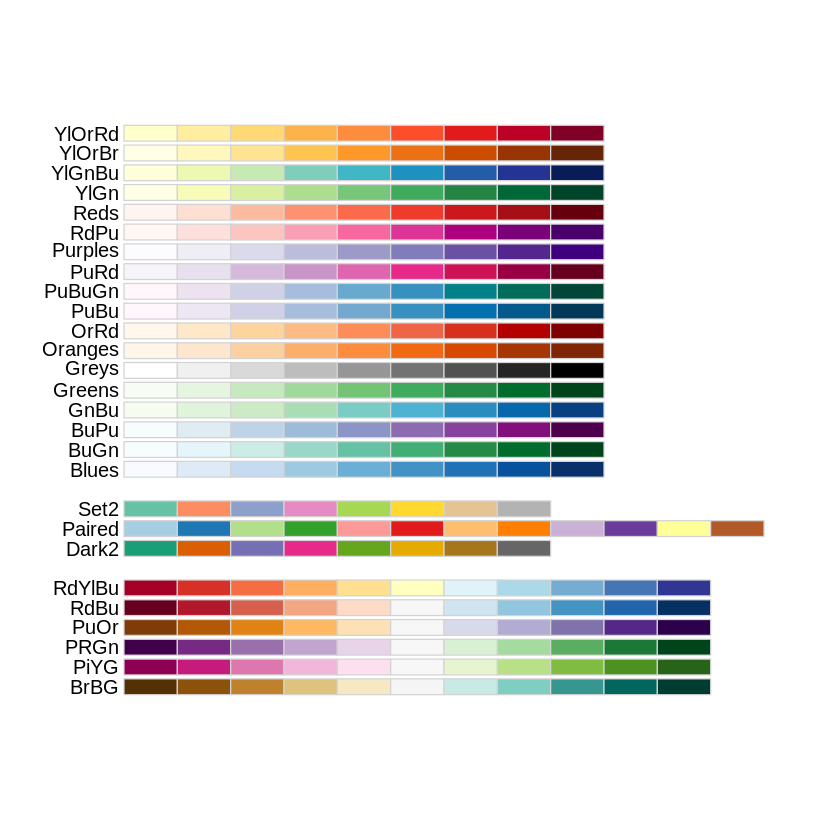

In [2]:
#Importing necessary libraries
library(tidyverse)
library(repr)
library(tidymodels)
library(RColorBrewer)
library(themis)
display.brewer.all(colorblindFriendly=TRUE) #viewing colour blind friendly colour palette options for plots

### Importing and tidying datasets

First I will import the specified databases into Jupyter. According to the source website, I then will change the corresponding variables from ,`<chr>` or `<int>` to `<fct>` using the `as_factor()` argument. Next, to make the data easier for R to work with and allow using of functions like `na.rm` to work in the future, I will mutate all columns to change the "?" to "NA". 

Lastly, I will create the new variable `disease` by mutating the current `num` variable to classify all different severities of heart disease `1,2,3,4` as `Yes` to indicate disease presence, and `0` as `No` to indicate disease absence.

In [3]:
#Importing and tidying Cleveland and Hungary Datasets
cleveland_data <- read_csv("heart_disease/processed.cleveland.data",col_names = 
                           c("age", "sex", "cp", "trestbps", "chol", "fbs", "restecg", "thalach", "exang", 
                             "oldpeak", "slope", "ca", "thal", "num")) |>                                      #importing data and adding column names
                   
                    mutate(sex = as_factor(sex),cp = as_factor(cp), fbs = as_factor(fbs),                      #changing categorical variables to factors
                               restecg = as_factor(restecg),exang = as_factor(exang), 
                           slope = as_factor(slope), thal = as_factor(thal), num = as_factor(num)) |>
                    mutate(ca = fct_recode(ca, "NA" = "?"))    |>                                          #replacing all "?" with NA's
                    mutate(disease = fct_recode(num, "Yes" = "1", "Yes" = "2", "Yes" = "3", "Yes" = "4", "No" = "0"))

hungary_data <- read_csv("heart_disease/processed.hungarian.data",col_names = 
                         c("age", "sex", "cp", "trestbps", "chol", "fbs", "restecg", 
                           "thalach", "exang", "oldpeak", "slope", "ca", "thal", "num")) |>                    #importing data and adding column names

                mutate(sex = as_factor(sex),cp = as_factor(cp), fbs = as_factor(fbs),                          #changing categorical variables to factors
                   restecg = as_factor(restecg),exang = as_factor(exang), 
                       slope = as_factor(slope), thal = as_factor(thal), num = as_factor(num)) |>

                mutate(ca = fct_recode(ca, "NA" = "?"), chol = fct_recode(chol, "NA" = "?"),                   #replacing all "?" with NA's
                       slope = fct_recode(slope, "NA" = "?"), thal = fct_recode(thal, "NA" = "?"))|>
                mutate(chol = as.integer(chol), trestbps = as.integer(trestbps)) |>                              #converting cholesterol & bp columns to integers
                mutate(disease = fct_recode(num, "Yes" = "1", "Yes" = "2", "Yes" = "3", "Yes" = "4", "No" = "0"))

cleveland_data
hungary_data

Rows: 303 Columns: 14
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr  (2): ca, thal
dbl (12): age, sex, cp, trestbps, chol, fbs, restecg, thalach, exang, oldpea...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Rows: 294 Columns: 14
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (9): trestbps, chol, fbs, restecg, thalach, exang, slope, ca, thal
dbl (5): age, sex, cp, oldpeak, num

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Warning message:
“There was 1 warning in `mutate()`.
ℹ In argument: `trestbps = as.integer(trestbps)`.
Caused by warning:
! NAs introduced by coercion”
Warning message:
“There was 1 warning in `mutate()`.
ℹ In argument: `disease = fct_recode(num, Y

age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,disease
<dbl>,<fct>,<fct>,<dbl>,<dbl>,<fct>,<fct>,<dbl>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>
63,1,1,145,233,1,2,150,0,2.3,3,0.0,6.0,0,No
67,1,4,160,286,0,2,108,1,1.5,2,3.0,3.0,2,Yes
67,1,4,120,229,0,2,129,1,2.6,2,2.0,7.0,1,Yes
37,1,3,130,250,0,0,187,0,3.5,3,0.0,3.0,0,No
41,0,2,130,204,0,2,172,0,1.4,1,0.0,3.0,0,No
56,1,2,120,236,0,0,178,0,0.8,1,0.0,3.0,0,No
62,0,4,140,268,0,2,160,0,3.6,3,2.0,3.0,3,Yes
57,0,4,120,354,0,0,163,1,0.6,1,0.0,3.0,0,No
63,1,4,130,254,0,2,147,0,1.4,2,1.0,7.0,2,Yes


age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,num,disease
<dbl>,<fct>,<fct>,<int>,<int>,<fct>,<fct>,<chr>,<fct>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>
28,1,2,130,5,0,2,185,0,0,NA,NA,NA,0,No
29,1,2,120,70,0,0,160,0,0,NA,NA,NA,0,No
29,1,2,140,1,0,0,170,0,0,NA,NA,NA,0,No
30,0,1,170,65,0,1,170,0,0,NA,NA,6,0,No
31,0,2,100,50,0,1,150,0,0,NA,NA,NA,0,No
32,0,2,105,31,0,0,165,0,0,NA,NA,NA,0,No
32,1,2,110,56,0,0,184,0,0,NA,NA,NA,0,No
32,1,2,125,79,0,0,155,0,0,NA,NA,NA,0,No
33,1,3,120,116,0,0,185,0,0,NA,NA,NA,0,No


**Figure 1** :
This table displays the raw data inputted from the web, with alterations made as described above the code cell. 

As we can see the data has now been correctly inputted and formatted, but we don't need all these variables. As such, we should select the variables we want to use, which is done below. 

### Selecting Variables of Interest

In [65]:
cleveland_model_data <- cleveland_data |>
select(disease, chol, trestbps)
cleveland_model_data 
hungary_model_data <- hungary_data |>
filter(!is.na(disease),!is.na(chol), !is.na(trestbps)) |>
select(disease, chol, trestbps)
hungary_model_data

disease,chol,trestbps
<fct>,<dbl>,<dbl>
No,233,145
Yes,286,160
Yes,229,120
No,250,130
No,204,130
No,236,120
Yes,268,140
No,354,120
Yes,254,130


disease,chol,trestbps
<fct>,<int>,<int>
No,5,130
No,70,120
No,1,140
No,65,170
No,50,100
No,31,105
No,56,110
No,79,125
No,116,120


**Figure 2** : Similar to figure 1 containing only selected variables required for future analysis.

Now that we've selected our variables of interest for the rest of the analysis, let's create a summary table with some average statistics to get a sense of our data.

### Creating Summary Table

In [66]:
cleveland_avg <- cleveland_train |>
            group_by(disease) |>
            summarize(number_of_patients = n(), 
                      avg_rbp = mean(trestbps), min_rbp = min(trestbps), max_rbp = max(trestbps), 
                      avg_chol = mean(chol), min_chol = min(chol), max_chol = max(chol))
cleveland_avg

hungary_avg <- hungary_train |>
            group_by(disease) |>
            summarize(number_of_patients = n(),  
                      avg_rbp = mean(trestbps, na.rm=TRUE), min_rbp = min(trestbps, na.rm=TRUE), 
                      max_rbp = max(trestbps, na.rm=TRUE), avg_chol = mean(chol), 
                      min_chol = min(chol), max_chol = max(chol))
hungary_avg

disease,number_of_patients,avg_rbp,min_rbp,max_rbp,avg_chol,min_chol,max_chol
<fct>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
No,123,130.4553,94,180,243.9106,157,417
Yes,104,135.5096,100,180,250.5673,131,407


disease,number_of_patients,avg_rbp,min_rbp,max_rbp,avg_chol,min_chol,max_chol
<fct>,<int>,<dbl>,<int>,<int>,<dbl>,<int>,<int>
No,141,130.6571,100,190,59.51773,1,154
Yes,79,134.7089,92,180,75.73418,1,152


**Figure 3** : Summarized data from figure 2 calculating average, maximum, and minimum resting blood pressure and cholesterol levels for both diseased and healthy patients in both the Cleveland and Hungary datasets, along with the number of patients in each category. 

Observing the summary data, while resting blood pressure ranges and averages appear to be very similar in both Cleveland and Hungary (ranges from ~92-~185 and averages ~130-135) the cholesterol data is much more varied. Both diseased and non diseased patients present cholesterol level averages almost 4x as high as hungarian patients, with the maximum cholesterol level in Hungary being only 154 compared to in Cleveland where it is 417! This vast difference in data may affect our predictive capabilities on the Hungary data once we fit to Cleveland, and we will keep this in mind moving forward.

### Preliminary Data Visualization

Now let's visualize our data using the Cleveland dataset to see if ther are any apparent relationships between our variables.

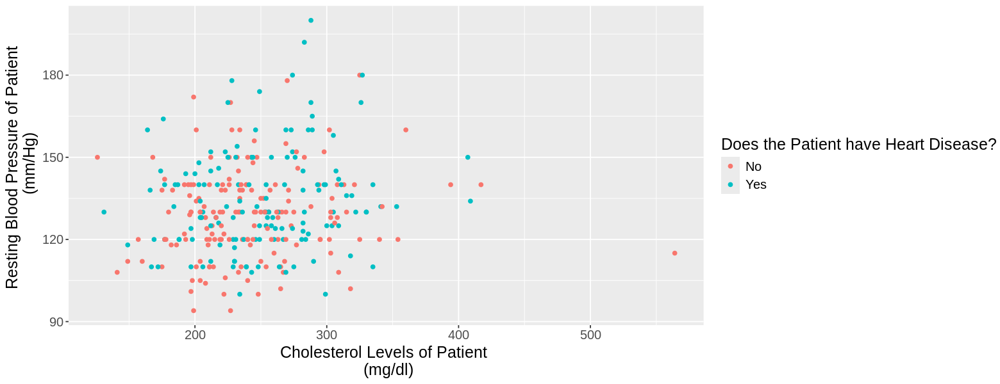

In [67]:
options(repr.plot.height = 5, repr.plot.width = 13)
cleveland_age_rbp_plot <- cleveland_model_data |>
ggplot(aes(x = chol, y = trestbps, colour = disease)) +
geom_point() +
labs(x=  "Cholesterol Levels of Patient \n (mg/dl)", y = "Resting Blood Pressure of Patient \n (mm/Hg)", colour = "Does the Patient have Heart Disease?") + 
theme(text=  element_text(size=15))
cleveland_age_rbp_plot

**Figure 4** : Scatterplot visualization of Resting Blood Pressure vs Cholesterol levels in Cleveland patients.

Upon analysis, there does not appear to be any obvious trends between our variables, with points scattered around the plot and ranges ~ matching up within the Cleveland data. This may impact us down the line, but let us see what our model tells us. 

### Establishing Majority Classifier Baseline

Before making our model, it's important for us to form a baseline to compare the accuracy/performance of our model to. For this, we will use the "majority classifier method". To do this, we will gatherthe proportions of "No" and "Yes" patients in the `disease` category of each dataset. We will then compare these values to the accuracies of our model predictions further down to see if the model predicts well, or if it is simply predicting the majority class everytime and/or not forming good predictions. 

#### Cleveland

In [68]:
cleveland_rows <- cleveland_model_data |> nrow()
cleveland_majority_classifier <- cleveland_model_data |>
group_by(disease) |>
summarize(percentage = n()/cleveland_rows) 
cleveland_majority_classifier

disease,percentage
<fct>,<dbl>
No,0.5412541
Yes,0.4587459


**Figure 5** : Proportions of healthy and diseased patients in the Cleveland dataset, to establish the Cleveland majority classifier baseline at 54.1% accuracy.

#### Hungary

In [69]:
hungary_rows <- hungary_model_data |> nrow()
hungary_majority_classifier <- hungary_model_data |>
group_by(disease) |>
summarize(percentage = n()/hungary_rows) 
hungary_majority_classifier

disease,percentage
<fct>,<dbl>
No,0.6382253
Yes,0.3617747


**Figure 6** : Proportions of healthy and diseased patients in the Hungary dataset, to establish the Cleveland majority classifier baseline at 63.8% accuracy.

## Tuning Model and Optimizing K-Value

### Splitting Data into Training and Testing

To form our model, we first split the data into training and testing sets, so that we can use the training data to form our model and test its capabilities on the test data. We will perform a 75%/25% split on the Cleveland data, as was common in inclass worksheets.

In [70]:
#Splitting into training and testing data
set.seed(1) 

cleveland_split <- initial_split(cleveland_model_data, prop = 0.75, strata = disease) 
cleveland_train <- training(cleveland_split) 
cleveland_test <- testing(cleveland_split)

### Creating Initial Model and Recipe

We then create a recipe and model, specifying the `tune()` argument in the `neighbors` argument to indicate we must tune to find an optimal k value. For our recipe we set disease as the category to predict and the `~.` to indicate all other variables (`chol` and `trestbps`) as our predictors.

In [119]:
set.seed(1)
cleveland_recipe <- recipe(disease ~ ., data = cleveland_train) |>
step_scale(all_predictors()) |>
step_center(all_predictors())

cleveland_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
set_engine("kknn") |>
set_mode("classification") 

### Performing Cross-Validation

Next, we create a tibble called `kvals` with the range of k values we want to test. We use `vfold_cv` to set up a cross-validation formula, performing 10 splits in our training data and inputting the vfold formula along with our k-values to test into a workflow with our model+recipe using `tune_grid`. 

Next, we collect the performance metrics of the cross-validation and filter to give us the accuracy metric. We then select the neighbors (k values) and mean (accuracy) columns to view the k value with the hgihest accuracy.

In [120]:
set.seed(1)
kvals <- tibble(neighbors = 1:100) 

cleveland_vfold <- vfold_cv(cleveland_train, v = 10, strata = disease)

cleveland_summary <- workflow() |>
add_model(cleveland_spec) |>
add_recipe(cleveland_recipe) |>
tune_grid(resamples = cleveland_vfold, grid = kvals) |>
collect_metrics() |>
filter(.metric == "accuracy") |>
select(mean, neighbors) |>
arrange(by = desc(mean)) 

### Summarizing and Visualizing Accuracy to Find Best K-Value

In [148]:
cleveland_summary |>
slice(1:10)

mean,neighbors
<dbl>,<int>
0.5639328,77
0.5639328,78
0.5635540,71
0.5635540,72
0.5631752,69
0.5631752,70
0.5593709,83
0.5593709,84
0.5591897,79


**Figure 7** : Table displaying the K values (in the `neighbors` column) with the highest accuracy values given from the cross-validation.

Above, we can see that the K-values of 77 and 78 provide the highest accuracy given our cross-validation. To make sure, we can also visualize the distribution of accuracy vs k-values.

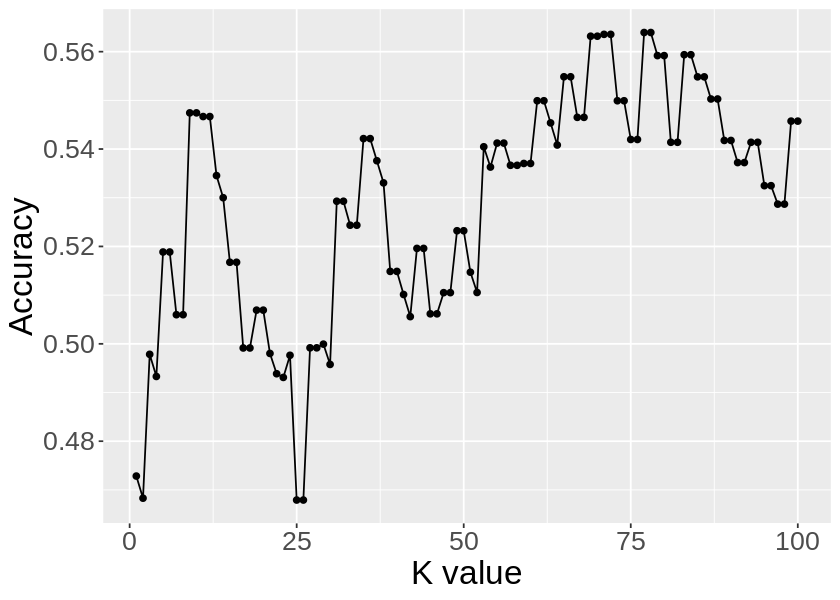

In [122]:
options(repr.plot.height = 5, repr.plot.width = 7)
cleveland_k_plot <- cleveland_summary |>
ggplot(aes(x = neighbors, y = mean)) +
geom_point() + geom_line() + 
labs(x = "K value", y = "Accuracy") +
theme(text = element_text(size = 20))
cleveland_k_plot

**Figure 8** : Visualization of Accuracy vs K value tested given by the cross-validation test. As described above, the K value with the highest accuracy should be selected to fit to the data.

Observing this plot, we can indeed see that both 77 and 78 present the highest points in the graph, meaning we can treat either one as the "best" k value to form our model with. Arbitrarily we will choose k = 77.

## Using Optimal K-Value to Construct and Utilize Final Model

### Creating New Model and Workflow + Performing Cleveland Test Data Predictions

Now, we create a new model `cleveland_best_spec` using our best k value, and add it to a workflow with our earlier recipe and fit it to the training data. 

We then use `predict()` to create predictions of the `disease` labels for our `cleveland_test` data using the fit we just created.

In [141]:
cleveland_best_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 77) |>
set_engine("kknn") |>
set_mode("classification") 

cleveland_best_fit <- workflow() |>
add_model(cleveland_best_spec) |>
add_recipe(cleveland_recipe) |>
fit(cleveland_train)

cleveland_predictions <- predict(cleveland_best_fit, cleveland_test) |>
bind_cols(cleveland_test) 
cleveland_predictions

.pred_class,disease,chol,trestbps
<fct>,<fct>,<dbl>,<dbl>
No,No,236,120
No,Yes,268,140
No,No,354,120
No,No,263,120
No,No,199,172
No,No,239,140
No,No,275,130
No,Yes,284,120
No,No,219,120


**Figure 9** : Displaying Cleveland test datatable with predictions of `disease` label performed by the newly made model added under the `.pred_class` column.

### Evaluating Cleveland Model with Matrix and Visualizations

Just seeing the columns doesn't give us a good sense of how well our model predicted the data, so let's create a confusion matrix along with collect the accuracy metric like we did earlier to see how the model did. 

In [142]:
cleveland_matrix <- conf_mat(cleveland_predictions, truth = disease, estimate = .pred_class)
cleveland_matrix

          Truth
Prediction No Yes
       No  39  28
       Yes  2   7

**Figure 10** : Confusion matrix for results of the Cleveland fit predictions. If we select the "Yes" label to be positive, we can calculate the precision of the model to be 7/9 = ~78%, and the recall to be 7/35 = ~20%. 

In [143]:
cleveland_model_metrics <- cleveland_predictions |>
metrics(truth = disease, estimate = .pred_class) |>
filter(.metric == "accuracy")
cleveland_model_metrics

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.6052632


**Figure 11** : Accuracy of results of the Cleveland fit predictions.

We can see that our model's accuracy of 60% is above the majority classifier's accuracy of 54%, but not overtly so. In the confusion matrix we can also see that there are more "No" classifications than there should be, with 28 points ID'ed as "No" actually being "Yes" for heart disease. While our model's precision is a respectable 78%, the recall for the model is far lower than desired at only 20%, meaning the vast majority of heart diseased patients would be going undiagnosed. Before going further, let's visualize our cleveland test data with a grid overlay of what our model is predicting, made following the same format as described in Chapter 5 of the dsci100 textbook.

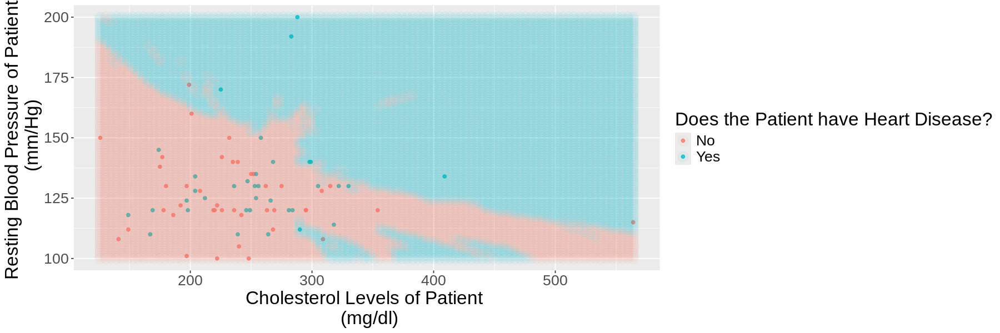

In [144]:
rbp_grid <- seq(min(cleveland_test$trestbps), max(cleveland_test$trestbps), length.out = 100) 
chol_grid <- seq(min(cleveland_test$chol), max(cleveland_test$chol), length.out = 100) 
final_grid <- as_tibble(expand.grid(trestbps = rbp_grid, chol = chol_grid))

grid_predictions <- predict(cleveland_best_fit, final_grid) |>
bind_cols(final_grid)

options(repr.plot.height = 5, repr.plot.width = 15)
cleveland_final_viz <- ggplot() +
geom_point(data = cleveland_test, mapping = aes(x = chol, y = trestbps, colour = disease), alpha = 0.8) +
geom_point(data = grid_predictions, mapping = aes(x = chol, y = trestbps, colour = .pred_class), alpha = 0.05, size = 5) +
labs(x=  "Cholesterol Levels of Patient \n (mg/dl)", y = "Resting Blood Pressure of Patient \n (mm/Hg)", colour = "Does the Patient have Heart Disease?") + 
theme(text=  element_text(size=20))
cleveland_final_viz

**Figure 12** : Plot of Cleveland test data with coloured overlay of predictions made by the Cleveland model.

Upon observing this graph, we can see that the borders of prediction are very jagged, suggesting that our model may be overfitted to the data. While this model ***does*** improve on the accuracy of the majority classifier, there seems to be a few issues with how well it performs. As discussed above, the recall of this model is also FAR lower than desired. This, along with the fact that no obvious variable relationship was seen in the preliminary visualization, leads me to believe that these two predictors may not be the optimal combination to use to predict the Cleveland data, but let's test the model on the Hungary data as well before proceeding with this line of thinking. 

## Using Model to Predict Hungary Data

Using the same Cleveland fit we've made, we use the `predict` function on the hungary data we created at the beginning, before creating a confusion matrix and gathering the accuracy of the data. 

In [145]:
hungary_predictions <- cleveland_best_fit |>
predict(hungary_model_data) |>
bind_cols(hungary_model_data) 

hungary_matrix <- conf_mat(hungary_predictions, truth = disease, estimate = .pred_class)
hungary_matrix

          Truth
Prediction  No Yes
       No  187 106
       Yes   0   0

**Figure 13** : Confusion matrix for results of the Hungary fit predictions. Calculating precision and recall for this data is futile since no positive predictions were ever made (discussed below). 

In [146]:
hungary_model_metrics <- hungary_predictions |>
metrics(truth = disease, estimate = .pred_class) |>
filter(.metric == "accuracy")
hungary_model_metrics

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.6382253


**Figure 14** : Accuracy of results of the Hungary fit predictions.

As we can see from the matrix and by comparing the model accuracy to the majority classifier (both 63.8%), we can see that this model is simply predicting "No" (the majority class) for each Hungary datapoint (i. the model is behaving asa majority classifier). Why might this be? Let's visualize the data in the same manner as the Cleveland set to better understand why this is occuring.

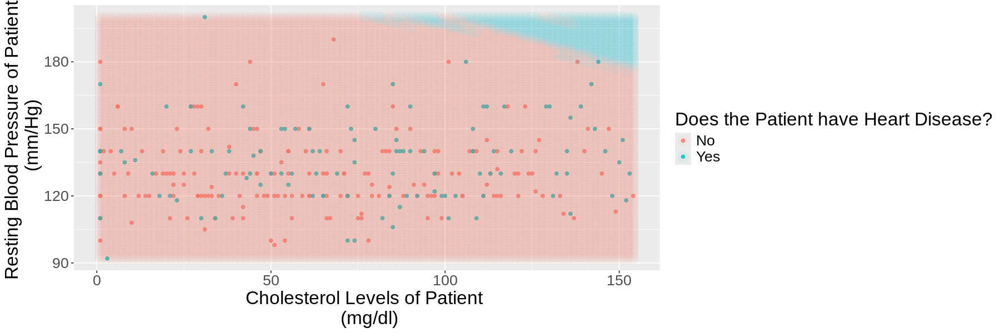

In [150]:
rbp_grid <- seq(min(hungary_model_data$trestbps), max(hungary_model_data$trestbps), length.out = 100) 
chol_grid <- seq(min(hungary_model_data$chol), max(hungary_model_data$chol), length.out = 100) 
final_grid <- as_tibble(expand.grid(trestbps = rbp_grid, chol = chol_grid))

grid_predictions <- predict(cleveland_best_fit, final_grid) |>
bind_cols(final_grid)

options(repr.plot.height = 5, repr.plot.width = 15)
hungary_final_viz <- ggplot() +
geom_point(data = hungary_model_data, mapping = aes(x = chol, y = trestbps, colour = disease), alpha = 0.8) +
geom_point(data = grid_predictions, mapping = aes(x = chol, y = trestbps, colour = .pred_class), alpha = 0.05, size = 5) +
labs(x=  "Cholesterol Levels of Patient \n (mg/dl)", y = "Resting Blood Pressure of Patient \n (mm/Hg)", colour = "Does the Patient have Heart Disease?") + 
theme(text=  element_text(size=20))
hungary_final_viz

**Figure 15** : Plot of all Hungary data data with coloured overlay of predictions made by the Hungary model.

As we can see, the model only predicts the very upper-right corner of the graph as having Heart Disease, and since there are no points in that region, no points are predicted to be labelled as "Yes". If we look at the magnitude of the axes, the blood pressure axis is consistent with the of Cleveland (both peaking at around 200), but, like in our earlier summary table, the cholesterol axis is of far lower magnitude in Hungary than in Cleveland (maxes out at ~150 whereas in Cleveland it goes up to 300-500). This is likely why the Cleveland fitted model has a hard time identifying the heart disease patients in Hungary, because it has been tuned to clasify heart idseae as having a much hgiher cholesterol level (at least around 300), so it doesn't identify any of the Hungarian patients, all of whom have far lower cholesterol than the average Cleveland patient, as having heart disease. 

### What to do Next

From this analysis, we can see that due to drastic differences in average cholesterol levels between locations, the model cannot be extrapolated from one location to another, and new models would likely have to be constructed to accurately predict heart disease labels in patients at each location. We've also seen that the model, while superior to the Cleveland majority classifier by ~6% accuracy, according the visualization seems to be an overfit of the data, along with having poor recall. Typically the overfit could be resolved by increasing the K-value but according to our cross-validation visualization (**Figure 8**), this leads to a drastic falloff in accuracy likely making the model worse than the majority classifier. As such, it is quite possible that this combination of variables simply isn't the optimal combination from the dataset to use to predict heart disease. 

However, there is one other possibility, especially in the case of the Hungary dataset, that could explain these results. It is possible that the majority-classification issues exhibited are due to the fact that Heart Disease patients are simply too rare in Hungary (only ~36% of patients in the database), as such, the dataset may be too imbalanced to accurately predict. We can test to see if this idea of balancing/upsampling our data helps solve our issues on either Cleveland or Hungary datasets. 

This can be done by simply copying all of the code we've done up to this point, except creating a new recipe for our model called `cleveland_up_recipe`, and adding the `step_upsample` argument to the recipe, as described in Chapter 5 of the dsci100 textbook. We specify with the `over_ratio` argument that we want the ratio of each label in the `disease` variable to be 1:1. 

Let us do this and repeat all our code from the above steps to see if this solves our issue.

## Testing with Upsampling

In [132]:
set.seed(1)
cleveland_up_recipe <- recipe(disease ~ ., data = cleveland_train) |>
step_upsample(disease, over_ratio = 1)

cleveland_up_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
set_engine("kknn") |>
set_mode("classification") 
set.seed(1)
kvals <- tibble(neighbors = 1:100) 

cleveland_up_vfold <- vfold_cv(cleveland_train, v = 10, strata = disease)

cleveland_up_summary <- workflow() |>
add_model(cleveland_up_spec) |>
add_recipe(cleveland_up_recipe) |>
tune_grid(resamples = cleveland_up_vfold, grid = kvals) |>
collect_metrics() |>
filter(.metric == "accuracy") |>
select(mean, neighbors) |>
arrange(by = desc(mean)) 

mean,neighbors
<dbl>,<int>
0.5855237,85
0.5855237,86
0.5811594,95
0.5807971,87
0.5807971,88
0.5769928,96
0.5726449,97
0.5726449,98
0.5673584,91


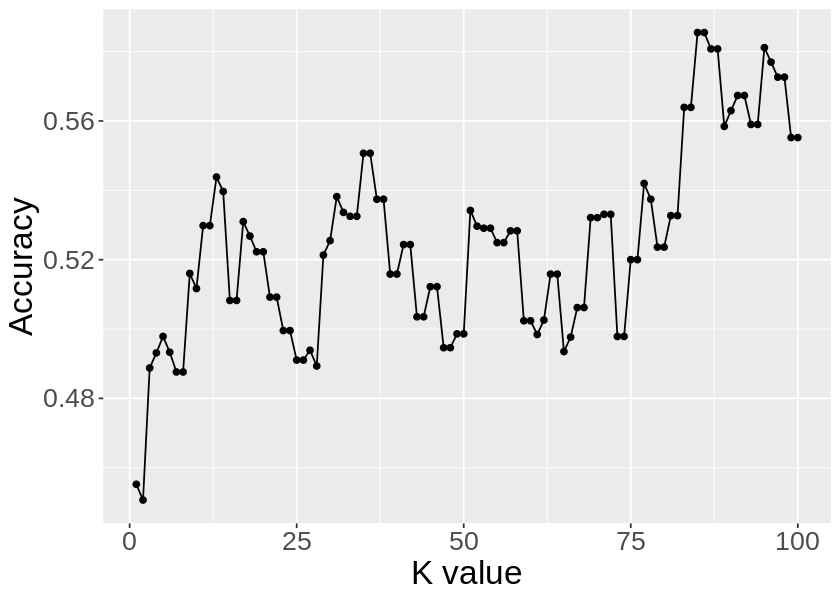

In [133]:
cleveland_up_summary |>
slice(1:50)

options(repr.plot.height = 5, repr.plot.width = 7)
cleveland_up_k_plot <- cleveland_up_summary |>
ggplot(aes(x = neighbors, y = mean)) +
geom_point() + geom_line() + 
labs(x = "K value", y = "Accuracy") +
theme(text = element_text(size = 20))
cleveland_up_k_plot

**Figure 16** : Same as **Figures 7 & 8** for the Cleveland data expect now considering the 1:1 ratio established by `step_upsample` in the recipe.

In [153]:
cleveland_up_best_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 85) |>
set_engine("kknn") |>
set_mode("classification") 

cleveland_up_best_fit <- workflow() |>
add_model(cleveland_up_best_spec) |>
add_recipe(cleveland_up_recipe) |>
fit(cleveland_train)

cleveland_up_predictions <- predict(cleveland_up_best_fit, cleveland_test) |>
bind_cols(cleveland_test) 
cleveland_up_predictions

.pred_class,disease,chol,trestbps
<fct>,<fct>,<dbl>,<dbl>
No,No,236,120
No,Yes,268,140
Yes,No,354,120
Yes,No,263,120
Yes,No,199,172
No,No,239,140
Yes,No,275,130
Yes,Yes,284,120
No,No,219,120


**Figure 17** : Same prediction format as **Figure 9** for the Cleveland data expect now considering the 1:1 ratio established by `step_upsample` in the recipe.

In [135]:
cleveland_up_matrix <- conf_mat(cleveland_up_predictions, truth = disease, estimate = .pred_class)
cleveland_up_matrix
cleveland_up_model_metrics <- cleveland_up_predictions |>
metrics(truth = disease, estimate = .pred_class) |>
filter(.metric == "accuracy")
cleveland_up_model_metrics

          Truth
Prediction No Yes
       No  26  16
       Yes 15  19

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.5921053


**Figure 18** : New upsampled confusion matrix and accuracy for the Cleveland dataset. Again treating "Yes" as positive, the new precision would be 19/34 = ~56% and the new recall would be 19/35 = ~54%. 

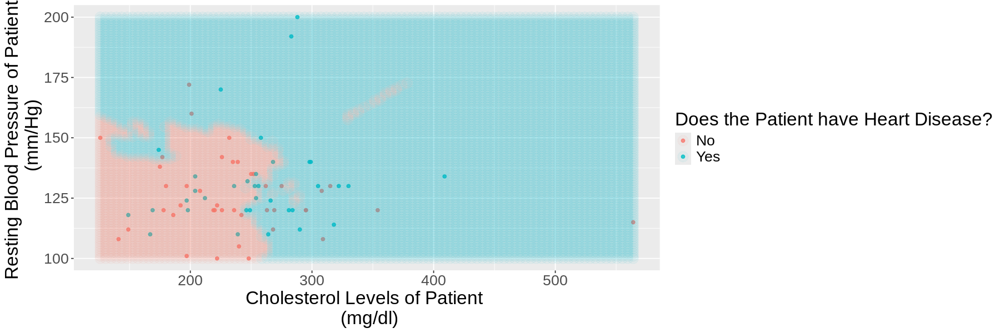

In [137]:
rbp_grid <- seq(min(cleveland_test$trestbps), max(cleveland_test$trestbps), length.out = 100) 
chol_grid <- seq(min(cleveland_test$chol), max(cleveland_test$chol), length.out = 100) 
final_grid <- as_tibble(expand.grid(trestbps = rbp_grid, chol = chol_grid))

grid_predictions <- predict(cleveland_up_best_fit, final_grid) |>
bind_cols(final_grid)

options(repr.plot.height = 5, repr.plot.width = 15)
cleveland_final_viz <- ggplot() +
geom_point(data = cleveland_test, mapping = aes(x = chol, y = trestbps, colour = disease), alpha = 0.8) +
geom_point(data = grid_predictions, mapping = aes(x = chol, y = trestbps, colour = .pred_class), alpha = 0.05, size = 5) +
labs(x=  "Cholesterol Levels of Patient \n (mg/dl)", y = "Resting Blood Pressure of Patient \n (mm/Hg)", colour = "Does the Patient have Heart Disease?") + 
theme(text=  element_text(size=20))
cleveland_final_viz

**Figure 19** : Same grid overlay style as **Figures 12 & 15** for predictions on upsampled Cleveland test data.

Observing the evaluation of the new Cleveland fit on Cleveland data, the accuracy as diminished (rom the previous model (from 60% to 59.2%). The overfitting in the graph appears to be improved slightly from the previous model, so a tradeoff has occured (slightly lowering accuracy to increase fit quality). A tradeoff has also occured between precision and recall, with the precision lowering from 78% to 56% and recall increasing from 20% to 54%. However, while our recall issue has been improved the overfit is still present despite the upsampling. The upsampling did not signficantly impact the Cleveland data since the proportions of `disease` labels in the data were already close to a 1:1 ratio (~55% to 45%), and as discussed earlier, K values cannot be signficantly increased due to limited data. As such, the fit did not drastically change. Due to this combination of factors, it seems likely that these predictors simply aren't the ideal combination with which to predict heart disease in Cleveland patients, as even an improved recall of 54% is not an ideal medical predictor (almost half of diseased patients going undiagnosed)!

In [138]:
hungary_up_predictions <- cleveland_up_best_fit |>
predict(hungary_model_data) |>
bind_cols(hungary_model_data) 

hungary_up_matrix <- conf_mat(hungary_up_predictions, truth = disease, estimate = .pred_class)
hungary_up_matrix

          Truth
Prediction  No Yes
       No  180  94
       Yes   7  12

**Figure 20** : New upsampled Hungary confusion matrix, now not behaving as majority classifier. With "Yes" as positive, the precision would be 12/19 = ~63% and the recall would be 12/106 = ~11%. 

In [139]:
hungary_up_model_metrics <- hungary_up_predictions |>
metrics(truth = disease, estimate = .pred_class) |>
filter(.metric == "accuracy")
hungary_up_model_metrics

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.6552901


**Figure 21** : Accuracy of upsampled Hungary predictions.

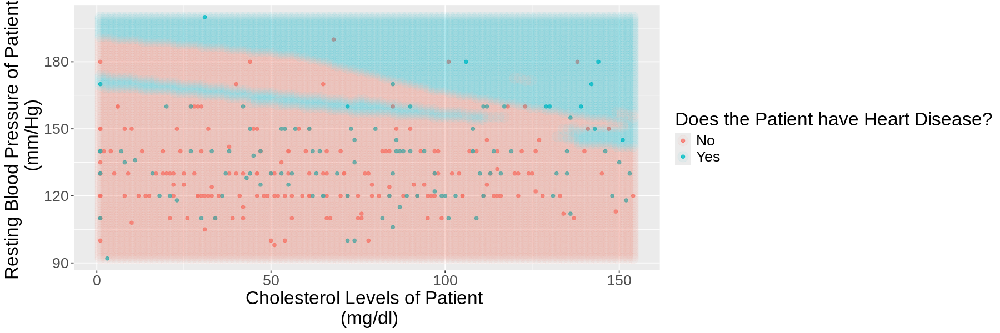

In [140]:
rbp_grid <- seq(min(hungary_model_data$trestbps), max(hungary_model_data$trestbps), length.out = 100) 
chol_grid <- seq(min(hungary_model_data$chol), max(hungary_model_data$chol), length.out = 100) 
final_grid <- as_tibble(expand.grid(trestbps = rbp_grid, chol = chol_grid))

grid_predictions <- predict(cleveland_up_best_fit, final_grid) |>
bind_cols(final_grid)

options(repr.plot.height = 5, repr.plot.width = 15)
hungary_final_viz <- ggplot() +
geom_point(data = hungary_model_data, mapping = aes(x = chol, y = trestbps, colour = disease), alpha = 0.8) +
geom_point(data = grid_predictions, mapping = aes(x = chol, y = trestbps, colour = .pred_class), alpha = 0.05, size = 5) +
labs(x=  "Cholesterol Levels of Patient \n (mg/dl)", y = "Resting Blood Pressure of Patient \n (mm/Hg)", colour = "Does the Patient have Heart Disease?") + 
theme(text=  element_text(size=20))
hungary_final_viz

**Figure 22** : Same grid overlay style as **Figures 12 & 15** for predictions on upsampled Hungary data.

Observing the fit on the Hungary data, the accuracy is now above that of the majority classifier (around 65% vs 63%), however the graph fit to the data appears overfit, and the accuracy is still not greatly increased compared to the majority classifier. Along with this, despite an ok 63% precision the recall of the model is rather abysmal at a mere 11%. As such, it appear that the Cleveland fit can not be effectively extrapolated to Hungary, likely due to the huge difference in cholesterol levels described earlier. While upscaling improved the model by fixing the (around 65% to 35%) imbalance in the data, it clearly was not the primary reason behind the model's lackluster performance. 

## Discussion

### Findings Summary
As discussed above, the Cleveland fit model presented an overfit to the data, with accuracy around 6% above the majority classifier and a lackluster 20% recall. This is an improvement but not ideal, and there are not enough datapoints avaiable to signficantly increase the K-value while maintaining relatively high accuracy (which one would typically do to reduce the overfit of the data). Upscaling the Cleveland data, did not provide any significant benefits either, only slightly decreasing the overfit (along with the accuracy) and increasing the recall to 54%. The initial Hungary predictions behaved as a majority classifier (predicted "No" for every data point) and the upsampling improved the accuracy by 2% (since the data was quite imbalanced with 65% no and 35% yes), although this didnt signficantly impact the models performance either. 

Overall as discussed above, the model likely didnt perform ideally on Cleveland's data simply due to the fact that there is no obvious relationship between the resting blood pressure and cholesterol variables (as discussed in **Figure 4**), and the inability to extrapolate to Hungary is likely due to the huge difference in cholesterol levels, as described in **Figure 3** and the Hungary analysis. 

In regards to our question and objective 1 (on if resting blood pressure and cholesterol are viable heart disease predictors), this likely means that this combination of viable simply isn't ideal to predict heart disease presence, suggesting that other column combinations from the dataset may provide better predictions of the data. In regards to objective 2 (whether the model can be extrapolated to Hungary), this displays that different locations can greatly differ in certain variables (like Cholesterol here), and heart disease risk factors can vary between locations. For instance, cholesterol may be very high in Cleveland patients, but since Hungarians typically have lower cholesterol levels, they may have other risk factors associated with the disease instead (thus training the model with an unassociated factor can throw off predictions). 

Due to the likely difference in proper predictors between locations, it seems unwise to try to use a model made for one location to predict disease in other location's patients, and instead models should be designed on a location dependent basis, considering risk predictors more valuable depending on the average citizens lifestyle. 

### Conclusions and Impact
Overall this project has displayed that resting blood pressure and cholesterol may provide some level of predictive power on Cleveland data, but likely aren't the ideal combination of variables to perform predictions with (in either location), indicating to medical professionals that there could be other variables with more predictive power. It has also shown that important variables/models appear to be location dependent, and since important predictors may vary between locations, models designed for one location likely shoudln't be used to predict disease presence in other location's patients, preventing potential misdiagnoses such actions could lead to. 

### Future Questions
Some future questions to test from the findings of this project could be ;
1) What predictors allow for better Cleveland dataset predictions?
2) Can the model be extrapolated to non-Hungarian datasets or is there consistent location dependence?
3) What predictors can be used to predict heart disease in Hungarian patients?

## Bibliography

Janosi, Andras, et al. “Heart Disease.” UCI Machine Learning Repository, 30 June 1988, https://doi.org/10.24432/C52P4X. Accessed 18 June 2024. 

“Heart Failure Signs and Symptoms.” www.heart.org, 7 June 2024, www.heart.org/en/health-topics/heart-failure/warning-signs-of-heart-failure.

Canto, John G., Kiefe, Catarina I., Rogers, William J. (2011). “Number of Coronary Heart Disease Risk Factors and Mortality in Patients With First Myocardial Infarction.” JAMA, vol. 306, no. 19, Nov. 2011, https://doi.org/10.1001/jama.2011.1654.

“Heart Disease - Symptoms and Causes - Mayo Clinic.” Mayo Clinic, 25 Aug. 2022, www.mayoclinic.org/diseases-conditions/heart-disease/symptoms-causes/syc-20353118.

Timbers, Tiffany, et al. "Data Science: A First Introduction." Data Science. 23 Dec. 2023, datasciencebook.ca/classification1.html. Accessed 18 June 2024.